In [1]:
import sys
import os

# !pip install pandas
# !pip install seaborn
# !pip install qiskit-aer
import pandas as pd
import numpy as np

import random
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import norm, skewnorm, t, chi2, gamma
from scipy.stats import kstest
import json
import math

from qiskit.synthesis import LieTrotter
from qiskit.transpiler import CouplingMap
from qiskit_addon_utils.problem_generators import generate_xyz_hamiltonian
from qiskit_addon_utils.problem_generators import generate_time_evolution_circuit
from qiskit.quantum_info import SparsePauliOp

src_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'utils'))
if src_path not in sys.path:
    sys.path.append(src_path)

from qiskit_addon_obp.classical_shadows import run_shadow, calculate_shadow_sample_complexity
from qiskit_addon_obp.run import run_many, obp_protocol
from qiskit_addon_obp.obp import run_backpropagation

/var/folders/zw/x8tsqxcx3lzdfvcr_bhldgg80000gn/T/ipykernel_77510/2604375395.py:18: DeprecationWarning: Using Qiskit with Python 3.9 is deprecated as of the 2.1.0 release. Support for running Qiskit with Python 3.9 will be removed in the 2.3.0 release, which coincides with when Python 3.9 goes end of life.
  from qiskit.synthesis import LieTrotter
/Users/kevindougherty/Documents/GitHub/qiskit-addon-obp/.venv/lib/python3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(


In [34]:
data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'data_target_depth_70'))

In [35]:
test_df = pd.read_pickle(f'{data_path}/test.pkl')
test_df

,backpropagated slices,number of terms,number of groups,max error,error is bounded by,bp_obs,bp_circuit,obs,circuit,bp_circuit_depth,bp_exp,exact_exp,total_exp,obs_shad_dict,num_meas,circuit_depth,abs_bp_error,abs_total_error,bp_error,total_error
0,20,34,14,0.0001,0.001999,"[[[SparsePauliOp(['ZZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.941781,0.943229,1.001684,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.001448,0.058455,0.001448,-0.058455
1,20,48,17,0.0001,0.001985,"[[[SparsePauliOp(['ZXIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZXIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.150880,0.149610,0.076058,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.001270,0.073551,-0.001270,0.073551
2,20,41,17,0.0001,0.001991,"[[[SparsePauliOp(['ZYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,-0.166322,-0.174343,-0.444996,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.008021,0.270653,-0.008021,0.270653
3,20,36,15,0.0001,0.001980,"[[[SparsePauliOp(['XXIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",XXIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.020405,-0.000036,-0.459683,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.020441,0.459647,-0.020441,0.459647
4,20,35,14,0.0001,0.001980,"[[[SparsePauliOp(['XZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",XZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.136593,0.138799,-0.466868,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.002207,0.605668,0.002207,0.605668
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76,20,35,14,0.0001,0.001980,"[[[SparsePauliOp(['XZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",XZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.145376,0.138799,0.121322,"[{'obs': 'ZZIIIIIIII', 'estimate': 0.967233009...",304200,90,0.006577,0.017478,-0.006577,0.017478
77,20,37,17,0.0001,0.001986,"[[[SparsePauliOp(['XYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",XYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.036703,0.052382,0.032587,"[{'obs': 'ZZIIIIIIII', 'estimate': 0.967233009...",304200,90,0.015679,0.019795,0.015679,0.019795
78,20,34,14,0.0001,0.001977,"[[[SparsePauliOp(['YYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",YYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.046208,0.053676,0.054369,"[{'obs': 'ZZIIIIIIII', 'estimate': 0.967233009...",304200,90,0.007468,0.000693,0.007468,-0.000693
79,20,35,14,0.0001,0.001970,"[[[SparsePauliOp(['YZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",YZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,-0.195531,-0.191294,-0.221994,"[{'obs': 'ZZIIIIIIII', 'estimate': 0.967233009...",304200,90,0.004237,0.030700,0.004237,0.030700


In [36]:
test_18_df = pd.read_pickle(f'{data_path}/test_18.pkl')
# test_18_df

In [37]:
test_36 = pd.read_pickle(f'{data_path}/test_36.pkl')
# test_36

In [38]:
obp_res_18_df = pd.read_pickle(f'{data_path}/obp_res_18.pkl')
# obp_res_18_df

In [39]:
obp_res_36 = pd.read_pickle(f'{data_path}/obp_res_36.pkl')
# obp_res_36

In [40]:
obp_res = pd.read_pickle(f'{data_path}/obp_res.pkl')
# obp_res

In [41]:
shad_res = pd.read_pickle(f'{data_path}/shad_res.pkl')
# shad_res

In [42]:
shad_res_18 = pd.read_pickle(f'{data_path}/shad_res_18.pkl')
# shad_res_18

In [43]:
shad_res_36 = pd.read_pickle(f'{data_path}/shad_res_36.pkl')
# shad_res_36

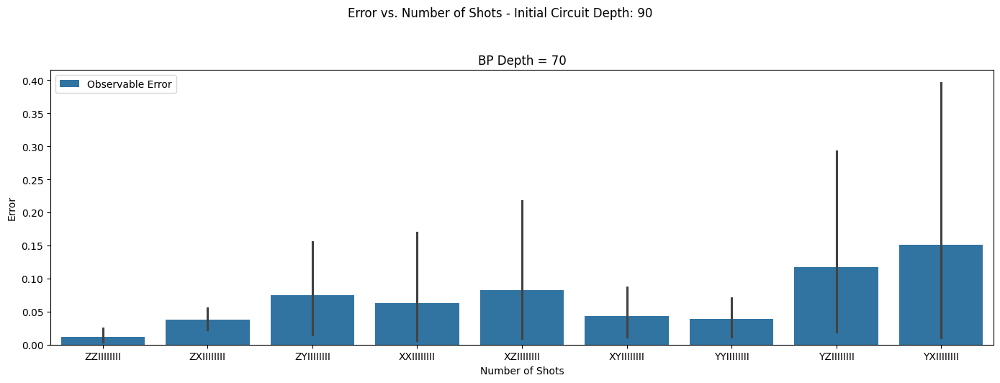

In [44]:
fig, ax = plt.subplots(1, 1, figsize=(14, 6), sharey=True)


sns.barplot(data=test_df, x='obs', y='abs_total_error', label='Observable Error')

plt.xlabel('Number of Shots')
plt.title(f'BP Depth = 70')

plt.ylabel('Error')

# fig.legend(title='Data Source', loc='lower center', ncol=2)

plt.suptitle(f"Error vs. Number of Shots - Initial Circuit Depth: 90")
plt.tight_layout(rect=[0, 0.1, 1, 0.95])
plt.show()

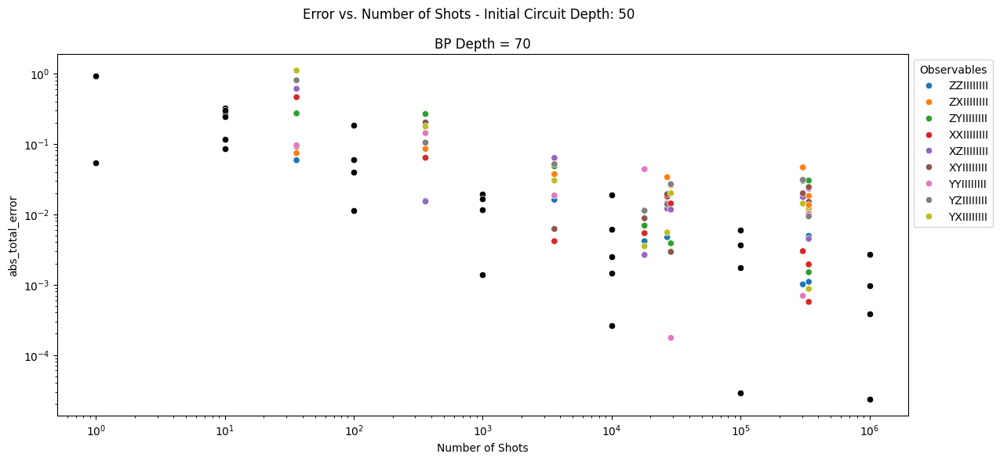

In [45]:
fig, ax = plt.subplots(1, 1, figsize=(14, 6), sharey=True)

sns.scatterplot(data=test_df, x='num_meas', y='abs_total_error', hue='obs')
sns.scatterplot(data=obp_res, x='obp_shots', y='bp_error', color='black')

plt.xscale('log')
plt.yscale('log')
plt.xlabel('Number of Shots')
plt.title(f'BP Depth = 70')

plt.legend(bbox_to_anchor=(1, 1), loc='upper left', title='Observables')

plt.suptitle(f"Error vs. Number of Shots - Initial Circuit Depth: 50")
plt.show()

In [46]:
def estimate_linear_variance(sparse_pauli, error_df):
    total_var = 0.0
    error_df = pd.DataFrame(error_df)  # Ensures it's a DataFrame if it's not already
    for pauli_term, coeff in zip(sparse_pauli.paulis.to_labels(), sparse_pauli.coeffs):
        match = error_df[error_df['obs'] == pauli_term]
        if not match.empty:
            var_i = match['error'].values[0]
        else:
            var_i = 0.0
        total_var += (coeff.real ** 2) * var_i ** 2
    return total_var

test_df['linear_variance_estimate'] = test_df.apply(
    lambda row: estimate_linear_variance(row['bp_obs'], row['obs_shad_dict']), axis=1
)


In [47]:
test_df

,backpropagated slices,number of terms,number of groups,max error,error is bounded by,bp_obs,bp_circuit,obs,circuit,bp_circuit_depth,...,exact_exp,total_exp,obs_shad_dict,num_meas,circuit_depth,abs_bp_error,abs_total_error,bp_error,total_error,linear_variance_estimate
0,20,34,14,0.0001,0.001999,"[[[SparsePauliOp(['ZZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,0.943229,1.001684,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.001448,0.058455,0.001448,-0.058455,0.006247
1,20,48,17,0.0001,0.001985,"[[[SparsePauliOp(['ZXIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZXIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,0.149610,0.076058,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.001270,0.073551,-0.001270,0.073551,0.028634
2,20,41,17,0.0001,0.001991,"[[[SparsePauliOp(['ZYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,-0.174343,-0.444996,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.008021,0.270653,-0.008021,0.270653,0.107775
3,20,36,15,0.0001,0.001980,"[[[SparsePauliOp(['XXIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",XXIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,-0.000036,-0.459683,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.020441,0.459647,-0.020441,0.459647,0.254186
4,20,35,14,0.0001,0.001980,"[[[SparsePauliOp(['XZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",XZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,0.138799,-0.466868,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.002207,0.605668,0.002207,0.605668,0.406048
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76,20,35,14,0.0001,0.001980,"[[[SparsePauliOp(['XZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",XZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,0.138799,0.121322,"[{'obs': 'ZZIIIIIIII', 'estimate': 0.967233009...",304200,90,0.006577,0.017478,-0.006577,0.017478,0.004061
77,20,37,17,0.0001,0.001986,"[[[SparsePauliOp(['XYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",XYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,0.052382,0.032587,"[{'obs': 'ZZIIIIIIII', 'estimate': 0.967233009...",304200,90,0.015679,0.019795,0.015679,0.019795,0.000651
78,20,34,14,0.0001,0.001977,"[[[SparsePauliOp(['YYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",YYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,0.053676,0.054369,"[{'obs': 'ZZIIIIIIII', 'estimate': 0.967233009...",304200,90,0.007468,0.000693,0.007468,-0.000693,0.000332
79,20,35,14,0.0001,0.001970,"[[[SparsePauliOp(['YZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",YZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,-0.191294,-0.221994,"[{'obs': 'ZZIIIIIIII', 'estimate': 0.967233009...",304200,90,0.004237,0.030700,0.004237,0.030700,0.000017


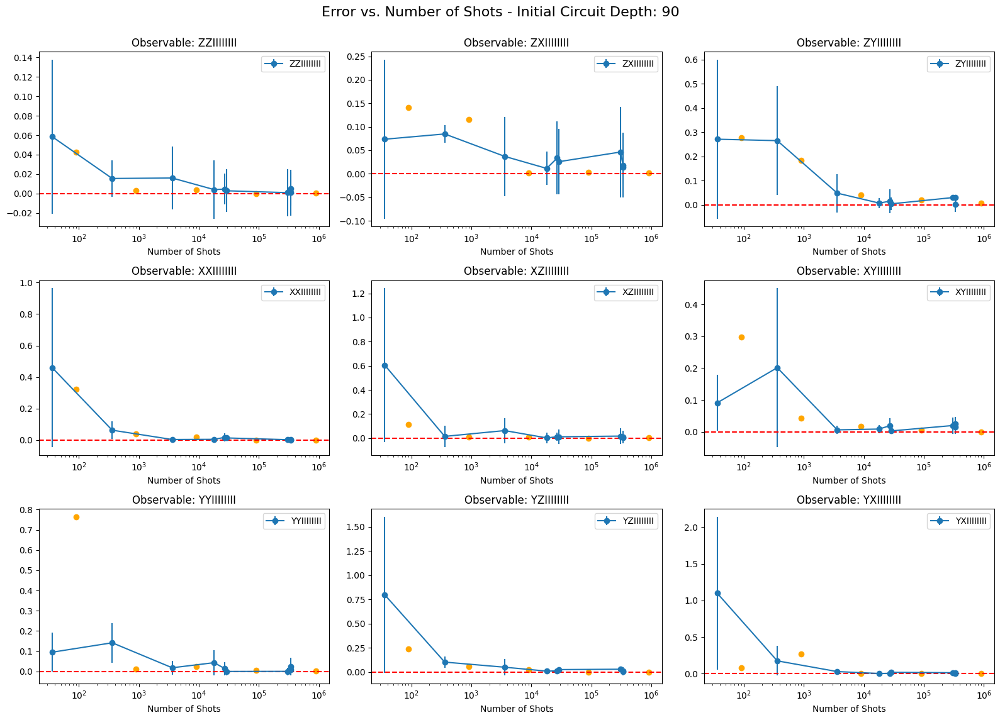

In [48]:
import matplotlib.pyplot as plt
import numpy as np

unique_obs = test_df['obs'].unique()
num_obs = len(unique_obs)

# Decide subplot grid shape (e.g. max 3 per row)
cols = 3
rows = (num_obs + cols - 1) // cols  # Ceiling division

fig, axes = plt.subplots(rows, cols, figsize=(16, rows * 4))
axes = axes.flatten()  # Flatten for easy indexing

for i, observable in enumerate(unique_obs):
    ax = axes[i]
    df_sub = test_df[test_df['obs'] == observable].sort_values(by='num_meas')
    obp_sub = obp_res[(obp_res['obs'] == observable) & (obp_res['obp_shots'] < 10**6) & (obp_res['obp_shots'] > 1)]

    ax.errorbar(x=df_sub['num_meas'],
                y=df_sub['abs_total_error'],
                yerr=np.sqrt(df_sub['linear_variance_estimate']),
                fmt='-o',
                label=f'{observable}')
    
    ax.scatter(x=obp_sub['obp_shots']*9,
               y=obp_sub['abs_bp_error'],
               color='orange')

    ax.axhline(y=0, color='red', linestyle='dashed')
    ax.set_xscale('log')
    # ax.set_yscale('log')  # Uncomment if desired

    ax.set_xlabel('Number of Shots')
    ax.set_title(f'Observable: {observable}')
    ax.legend(loc='best')

# Remove unused subplots if any
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

fig.suptitle(f'Error vs. Number of Shots - Initial Circuit Depth: {test_df["circuit_depth"][0]}', fontsize=16)
fig.tight_layout(rect=[0, 0.03, 1, 0.98])
plt.show()


In [49]:
obp_res.columns

Index(['backpropagated slices', 'number of terms', 'number of groups',
       'max error', 'error is bounded by', 'bp_obs', 'bp_circuit', 'obs',
       'circuit', 'bp_circuit_depth', 'bp_exp', 'exact_exp', 'obp_shots',
       'circuit_depth', 'abs_bp_error', 'bp_error'],
      dtype='object')

In [ ]:
# print(test_df[test_df['num_meas'] == 338000].iloc[0:9]['abs_total_error'].mean())
# print(test_df[test_df['num_meas'] == 338000].iloc[9:18]['abs_total_error'].mean())
test_df

,backpropagated slices,number of terms,number of groups,max error,error is bounded by,bp_obs,bp_circuit,obs,circuit,bp_circuit_depth,bp_exp,exact_exp,total_exp,obs_shad_dict,num_meas,circuit_depth,abs_bp_error,abs_total_error,bp_error,total_error
0,20,34,14,0.0001,0.001999,"[[[SparsePauliOp(['ZZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.941781,0.943229,1.001684,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.001448,0.058455,0.001448,-0.058455
1,20,48,17,0.0001,0.001985,"[[[SparsePauliOp(['ZXIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZXIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.150880,0.149610,0.076058,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.001270,0.073551,-0.001270,0.073551
2,20,41,17,0.0001,0.001991,"[[[SparsePauliOp(['ZYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,-0.166322,-0.174343,-0.444996,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.008021,0.270653,-0.008021,0.270653
3,20,36,15,0.0001,0.001980,"[[[SparsePauliOp(['XXIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",XXIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.020405,-0.000036,-0.459683,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.020441,0.459647,-0.020441,0.459647
4,20,35,14,0.0001,0.001980,"[[[SparsePauliOp(['XZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",XZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.136593,0.138799,-0.466868,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.002207,0.605668,0.002207,0.605668
5,20,37,17,0.0001,0.001986,"[[[SparsePauliOp(['XYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",XYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.055061,0.052382,-0.038750,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.002680,0.091132,-0.002680,0.091132
6,20,34,14,0.0001,0.001977,"[[[SparsePauliOp(['YYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",YYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.049638,0.053676,-0.041688,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.004038,0.095364,0.004038,0.095364
7,20,35,14,0.0001,0.001970,"[[[SparsePauliOp(['YZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",YZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,-0.180601,-0.191294,-0.990105,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.010693,0.798811,-0.010693,0.798811
8,20,38,15,0.0001,0.001992,"[[[SparsePauliOp(['YXIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",YXIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.045103,0.047347,-1.051516,"[{'obs': 'ZZIIIIIIII', 'estimate': 1.0, 'exact...",36,90,0.002245,1.098864,0.002245,1.098864
9,20,34,14,0.0001,0.001999,"[[[SparsePauliOp(['ZZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,0.943837,0.943229,0.927641,"[{'obs': 'ZZIIIIIIII', 'estimate': 0.95, 'exac...",360,90,0.000607,0.015588,-0.000607,0.015588


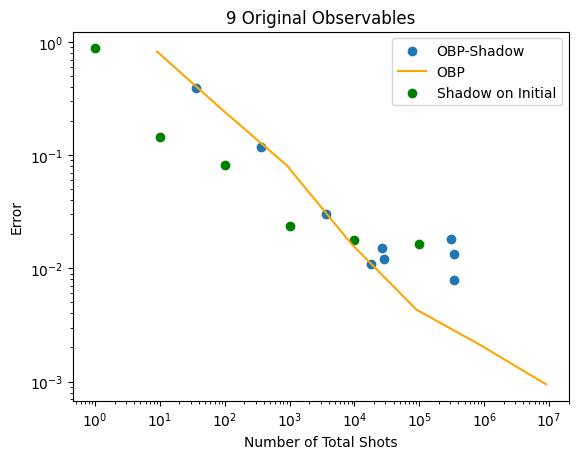

In [50]:
# since we have 9 obsrevables, find the average of every 9 rows:

obs_num = 9
test_df['obs_group'] = test_df.index // obs_num

gb1 = test_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb2 = obp_res.groupby('obp_shots').agg({'abs_bp_error': 'mean'}).reset_index()
gb2['obp_shots'] = gb2['obp_shots'] * obs_num
gb3 = shad_res.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='OBP-Shadow')
# plt.scatter(x=gb2['obp_shots']*9, y=gb2['abs_bp_error'], label='OBP')
sns.lineplot(data=gb2, x='obp_shots', y='abs_bp_error', label='OBP', color='orange')

plt.scatter(x=gb3['num_meas'], y=gb3['abs_shad_error'], label='Shadow on Initial', color='green')

plt.xscale('log')
plt.yscale('log')
plt.title('9 Original Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend()

In [51]:
"""
I need to run tests with:
- more observables to see if OBP-Shadow will scale similarly while OBP will require more shots
- OBP requires (number of observables) * (number of shots per observable)
- shadow just requires the numebr of measurements to be a log scaled with the accuracy and some constant
    - may be good to restrict our attention to low-weight paulis since this reduces the number of possibilities for measurement, we would have fewer unique backpropagated observables to measure
"""

'\nI need to run tests with:\n- more observables to see if OBP-Shadow will scale similarly while OBP will require more shots\n- OBP requires (number of observables) * (number of shots per observable)\n- shadow just requires the numebr of measurements to be a log scaled with the accuracy and some constant\n    - may be good to restrict our attention to low-weight paulis since this reduces the number of possibilities for measurement, we would have fewer unique backpropagated observables to measure\n'

In [52]:
shad_res_18

,shad_exp,exact_val,shad_error,abs_shad_error,num_meas
0,1.000000,0.943229,-0.056771,0.056771,1
1,1.000000,0.149610,-0.850390,0.850390,1
2,-1.000000,-0.174343,0.825657,0.825657,1
3,1.000000,-0.000036,-1.000036,1.000036,1
4,-1.000000,0.138799,1.138799,1.138799,1
...,...,...,...,...,...
85,0.132850,0.149308,0.016458,0.016458,10000
86,0.065217,0.043367,-0.021850,0.021850,10000
87,0.099034,0.064516,-0.034518,0.034518,10000
88,-0.189843,-0.171677,0.018166,0.018166,10000


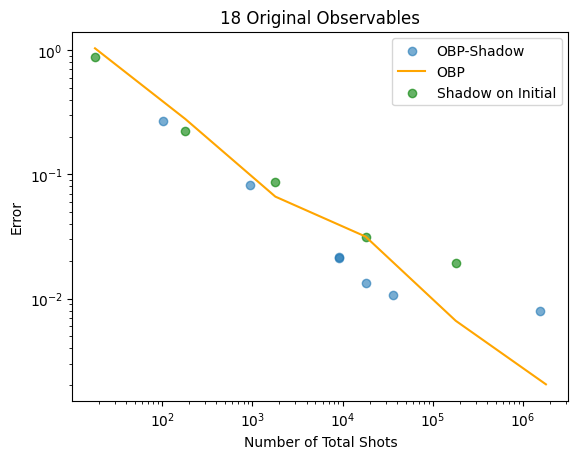

In [53]:
# since we have 18 obsrevables, find the average of every 18 rows:

obs_num = 18
test_18_df['obs_group'] = test_18_df.index // obs_num

gb1 = test_18_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb2 = obp_res_18_df.groupby('obp_shots').agg({'abs_bp_error': 'mean'}).reset_index()
gb2['obp_shots'] = gb2['obp_shots'] * obs_num
gb3 = shad_res_18.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='OBP-Shadow', alpha=0.6)

# plt.scatter(x=gb2['obp_shots']*18, y=gb2['abs_bp_error'], label='OBP', alpha=0.6)
sns.lineplot(data=gb2, x='obp_shots', y='abs_bp_error', label='OBP', color='orange')

plt.scatter(x=gb3['num_meas']*18, y=gb3['abs_shad_error'], label='Shadow on Initial', alpha=0.6, color='green')

plt.xscale('log')
plt.yscale('log')
plt.title('18 Original Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend()

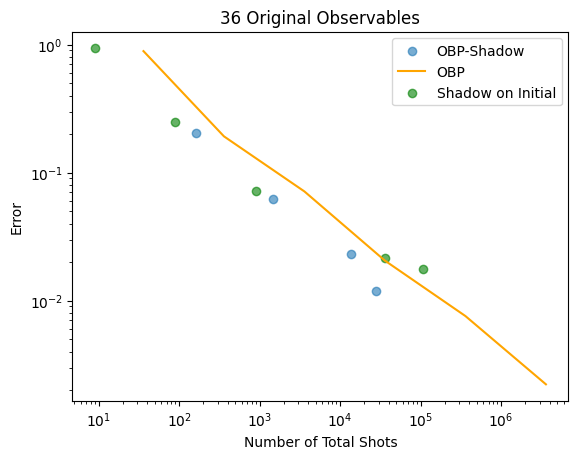

In [54]:
# since we have 36 obsrevables, find the average of every 36 rows:

obs_num = 36
test_36['obs_group'] = test_36.index // obs_num

gb1 = test_36.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb2 = obp_res_36.groupby('obp_shots').agg({'abs_bp_error': 'mean'}).reset_index()
gb2['obp_shots'] = gb2['obp_shots'] * obs_num
gb3 = shad_res_36.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='OBP-Shadow', alpha=0.6)
sns.lineplot(data=gb2, x='obp_shots', y='abs_bp_error', label='OBP', color='orange')
# plt.scatter(x=gb2['obp_shots']*36, y=gb2['abs_bp_error'], label='OBP', alpha=0.6)
plt.scatter(x=gb3['num_meas'], y=gb3['abs_shad_error'], label='Shadow on Initial', alpha=0.6, color='green')

plt.xscale('log')
plt.yscale('log')
plt.title('36 Original Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend()

I expect the ideal number of measurements to take about 14816411374794117120 minutes or 2.4694018957990195e+17 hours.
I expect the 338000 measurements to take about 88 minutes or 1.47 hours.


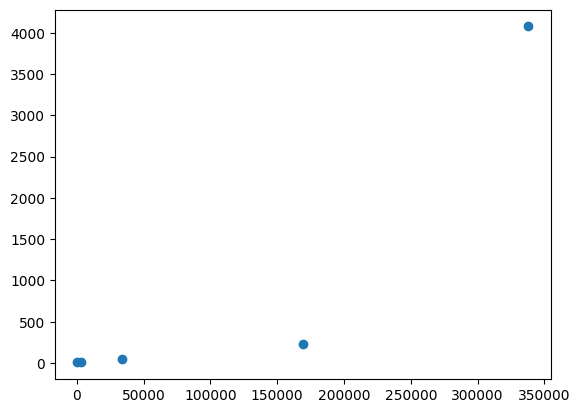

In [55]:
import math
from scipy.optimize import curve_fit

def logarithmic_func(x, a, b):
    return a * np.log(x) + b

meas = [338, 3380, 33800, 169000, 338000]
times = [7.035, 10.985, 51.675, 234.548, 4075.194]

popt, pcov = curve_fit(logarithmic_func, times, meas)
a_opt, b_opt = popt

y1 = np.exp((2528916.70028 - b_opt) / a_opt)
y2 = np.exp((338000 - b_opt) / a_opt)

print(f"I expect the ideal number of measurements to take about {math.ceil(y1/60)} minutes or {round(math.ceil(y1/60)/60, 2)} hours.")
print(f"I expect the {338000} measurements to take about {math.ceil(y2/60)} minutes or {round(math.ceil(y2/60)/60, 2)} hours.")

plt.scatter(meas, times)

x_fit = np.linspace(min(meas), max(meas), 100)
# y_fit = logarithmic_func(x_fit, a_opt, b_opt)
# plt.plot(x_fit, y_fit, 'r-', label='Fitted Logarithmic Curve')

In [56]:
pw5_9obs = pd.read_pickle(f'{data_path}/pw5_9obs.pkl')
pw7_9obs = pd.read_pickle(f'{data_path}/pw7_9obs.pkl')
mixed_pw7_9obs = pd.read_pickle(f'{data_path}/mixed_pw7_9obs.pkl')

FileNotFoundError: [Errno 2] No such file or directory: '/Users/kevindougherty/Documents/GitHub/qiskit-addon-obp/qiskit_addon_obp/data_target_depth_70/mixed_pw7_9obs.pkl'

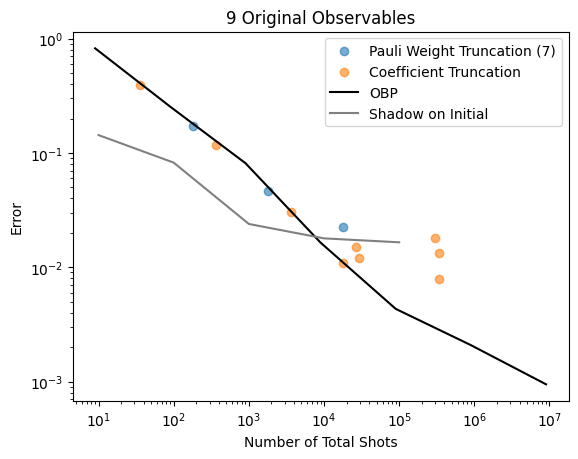

In [57]:
obs_num = 9
pw7_9obs['obs_group'] = pw7_9obs.index // obs_num
# mixed_pw7_9obs['obs_group'] = mixed_pw7_9obs.index // obs_num

gb1 = pw7_9obs.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
# gb2 = mixed_pw7_9obs.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb3 = test_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_res.groupby('obp_shots').agg({'abs_bp_error': 'mean'}).reset_index()
gb_obp['obp_shots'] = gb_obp['obp_shots'] * obs_num

gb_shad = shad_res.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()
gb_shad = gb_shad[gb_shad['num_meas'] >= 10]

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6)
# plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Mixed Truncation', alpha=0.6)
plt.scatter(x=gb3['num_meas'], y=gb3['abs_total_error'], label='Coefficient Truncation', alpha=0.6)

sns.lineplot(data=gb_obp, x='obp_shots', y='abs_bp_error', label='OBP', color='black')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')

# plt.scatter(x=gb_obp['obp_shots']*9, y=gb_obp['abs_bp_error'], label='OBP', alpha=0.6)
# plt.scatter(x=gb3['num_meas'], y=gb3['abs_shad_error'], label='Shadow on Initial', alpha=0.6, color='green')

plt.xscale('log')
plt.yscale('log')
plt.title('9 Original Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend()

In [59]:
pw7_18obs = pd.read_pickle(f'{data_path}/pw7_18obs.pkl')
# mixed_pw7_18obs = pd.read_pickle(f'{data_path}/mixed_pw7_18obs.pkl')
shad_res_18 = pd.read_pickle(f'{data_path}/shad_res_18.pkl')

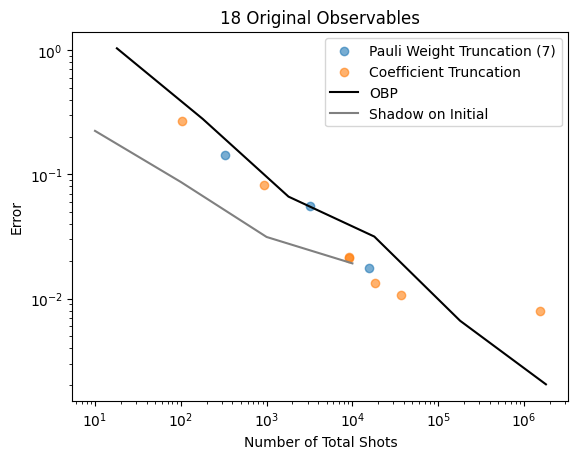

In [60]:
obs_num = 18
pw7_18obs['obs_group'] = pw7_18obs.index // obs_num
# mixed_pw7_18obs['obs_group'] = mixed_pw7_18obs.index // obs_num

gb1 = pw7_18obs.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
# gb2 = mixed_pw7_18obs.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb3 = test_18_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_res_18_df.groupby('obp_shots').agg({'abs_bp_error': 'mean'}).reset_index()
gb_obp['obp_shots'] = gb_obp['obp_shots'] * obs_num

gb_shad = shad_res_18.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()
gb_shad = gb_shad[gb_shad['num_meas'] >= 10]

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6)
# plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Mixed Truncation', alpha=0.6)
plt.scatter(x=gb3['num_meas'], y=gb3['abs_total_error'], label='Coefficient Truncation', alpha=0.6)

sns.lineplot(data=gb_obp, x='obp_shots', y='abs_bp_error', label='OBP', color='black')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')

# plt.scatter(x=gb_obp['obp_shots']*9, y=gb_obp['abs_bp_error'], label='OBP', alpha=0.6)
# plt.scatter(x=gb3['num_meas'], y=gb3['abs_shad_error'], label='Shadow on Initial', alpha=0.6, color='green')

plt.xscale('log')
plt.yscale('log')
plt.title('18 Original Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend()

9 observables
- Pauli weight truncation (7) - pw7_9obs.pkl
    - 1000
- Mixed - mixed_pw7_9obs.pkl
    - 1000

18 observables
- Pauli weight truncation (7) - pw7_18obs.pkl
    - 200, 500, 800, 1000
- Mixed - mixed_pw7_18obs.pkl
    - 500, 800, 1000
- Shadow - shad_res_18.pkl
    - 10000

36 observables
- Shadow - shad_res_36.pkl
    - 1000
- Coefficient - test_36.pkl
    - 1000
- Pauli weight truncation (7) - pw7_36obs.pkl
    - 100, 200, 500, 800, 1000
- Mixed - mixed_pw7_36obs.pkl
    - 500, 800, 1000

In [61]:
pw7_36obs = pd.read_pickle(f'{data_path}/pw7_36obs.pkl')
# mixed_pw7_36obs = pd.read_pickle(f'{data_path}/mixed_pw7_36obs.pkl')
shad_res_36 = pd.read_pickle(f'{data_path}/shad_res_36.pkl')

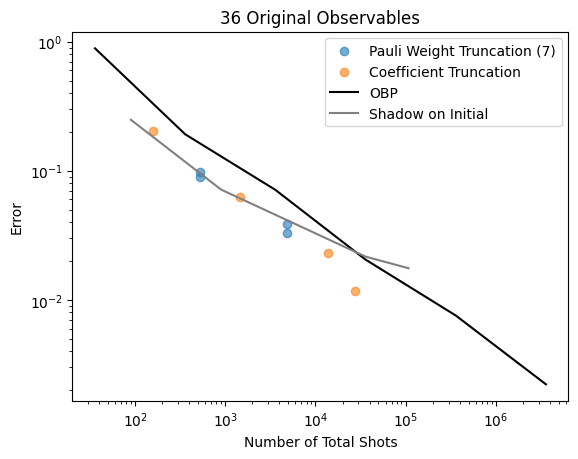

In [62]:
obs_num = 36
pw7_36obs['obs_group'] = pw7_36obs.index // obs_num
# mixed_pw7_36obs['obs_group'] = mixed_pw7_36obs.index // obs_num
test_36['obs_group'] = test_36.index // obs_num

gb1 = pw7_36obs.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
# gb2 = mixed_pw7_36obs.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb3 = test_36.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_res_36.groupby('obp_shots').agg({'abs_bp_error': 'mean'}).reset_index()
gb_obp['obp_shots'] = gb_obp['obp_shots'] * obs_num

gb_shad = shad_res_36.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()
gb_shad = gb_shad[gb_shad['num_meas'] >= 10]

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6)
# plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Mixed Truncation', alpha=0.6)
plt.scatter(x=gb3['num_meas'], y=gb3['abs_total_error'], label='Coefficient Truncation', alpha=0.6)

sns.lineplot(data=gb_obp, x='obp_shots', y='abs_bp_error', label='OBP', color='black')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')

# plt.scatter(x=gb_obp['obp_shots']*9, y=gb_obp['abs_bp_error'], label='OBP', alpha=0.6)
# plt.scatter(x=gb3['num_meas'], y=gb3['abs_shad_error'], label='Shadow on Initial', alpha=0.6, color='green')

plt.xscale('log')
plt.yscale('log')
plt.title('36 Original Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend()

16.0


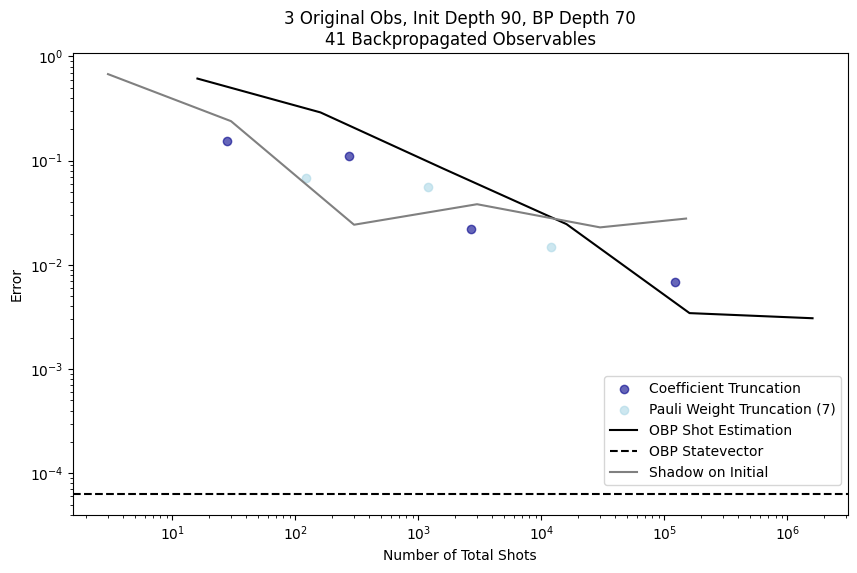

In [155]:
data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'data2'))
coef_df = pd.read_pickle(f'{data_path}/coef-trunc_init90_bp70_obs3.pkl')
pauli_df = pd.read_pickle(f'{data_path}/pauli-trunc7_init90_bp70_obs3.pkl')
obp_df = pd.read_pickle(f'{data_path}/obp_bp70_obs3.pkl')
shad_df = pd.read_pickle(f'{data_path}/shad_res_3.pkl')
# data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'data3'))
# meas_again_df = pd.read_pickle(f'{data_path}/test.pkl')

obp_df['num_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.paulis))
obp_df['num_qwc_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.group_commuting(qubit_wise=True)))
obp_df['num_total_shots'] = obp_df['num_qwc_bp_obs'] * obp_df['obp_shots']

obs_num = 3
coef_df['obs_group'] = coef_df.index // obs_num
obp_df['obs_group'] = obp_df.index // obs_num
shad_df['obs_group'] = shad_df.index // obs_num
pauli_df['obs_group'] = pauli_df.index // obs_num

gb1 = coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb2 = pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_df.groupby('obs_group').agg({'num_total_shots': 'mean', 'abs_bp_error_shots': 'mean'}).reset_index()

gb_shad = shad_df.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()

plt.figure(figsize=(10, 6))

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Coefficient Truncation', alpha=0.6, color='darkblue')
plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6, color='lightblue')

# plt.axhline(y=gb3['abs_total_error'].mean(), label='Coefficient Truncation Statevector', color='darkblue')
# plt.axhline(y=gb4['abs_total_error'].mean(), label='Pauli Truncation (7) Statevector', color='lightblue', linestyle='--')

sns.lineplot(data=gb_obp, x='num_total_shots', y='abs_bp_error_shots', label='OBP Shot Estimation', color='black')
plt.axhline(y=obp_df['abs_bp_error_state'].mean(), color='black', linestyle='--', label='OBP Statevector')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')

plt.xscale('log')
plt.yscale('log')
plt.title(f'3 Original Obs, Init Depth 90, BP Depth 70\n{int(math.ceil(obp_df["num_bp_obs"].mean()))} Backpropagated Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend(loc='lower right', bbox_to_anchor=(1, 0.05))

print(obp_df['num_qwc_bp_obs'].mean())

In [146]:
obp_df

,backpropagated slices,number of terms,number of groups,max error,error is bounded by,bp_obs,bp_circuit,obs,circuit,bp_circuit_depth,...,obp_shots,circuit_depth,abs_bp_error_shots,bp_error_shots,abs_bp_error_state,bp_error_state,num_bp_obs,num_qwc_bp_obs,num_total_shots,obs_group
0,20,34,14,0.0001,0.001999,"[[[SparsePauliOp(['ZZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,1,90,0.017884,0.017884,0.000028,0.000028,34,14,14,0
1,20,48,17,0.0001,0.001985,"[[[SparsePauliOp(['ZXIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZXIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,1,90,1.105654,1.105654,0.000139,-0.000139,48,17,17,0
2,20,41,17,0.0001,0.001991,"[[[SparsePauliOp(['ZYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,1,90,0.717912,0.717912,0.000022,-0.000022,41,17,17,0
3,20,34,14,0.0001,0.001999,"[[[SparsePauliOp(['ZZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,10,90,0.130767,0.130767,0.000028,0.000028,34,14,140,1
4,20,48,17,0.0001,0.001985,"[[[SparsePauliOp(['ZXIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZXIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,10,90,0.508420,-0.508420,0.000139,-0.000139,48,17,170,1
5,20,41,17,0.0001,0.001991,"[[[SparsePauliOp(['ZYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,10,90,0.232636,0.232636,0.000022,-0.000022,41,17,170,1
6,20,34,14,0.0001,0.001999,"[[[SparsePauliOp(['ZZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,100,90,0.020449,0.020449,0.000028,0.000028,34,14,1400,2
7,20,48,17,0.0001,0.001985,"[[[SparsePauliOp(['ZXIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZXIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,100,90,0.164752,-0.164752,0.000139,-0.000139,48,17,1700,2
8,20,41,17,0.0001,0.001991,"[[[SparsePauliOp(['ZYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,100,90,0.065949,-0.065949,0.000022,-0.000022,41,17,1700,2
9,20,34,14,0.0001,0.001999,"[[[SparsePauliOp(['ZZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",70,...,1000,90,0.007959,-0.007959,0.000028,0.000028,34,14,14000,3


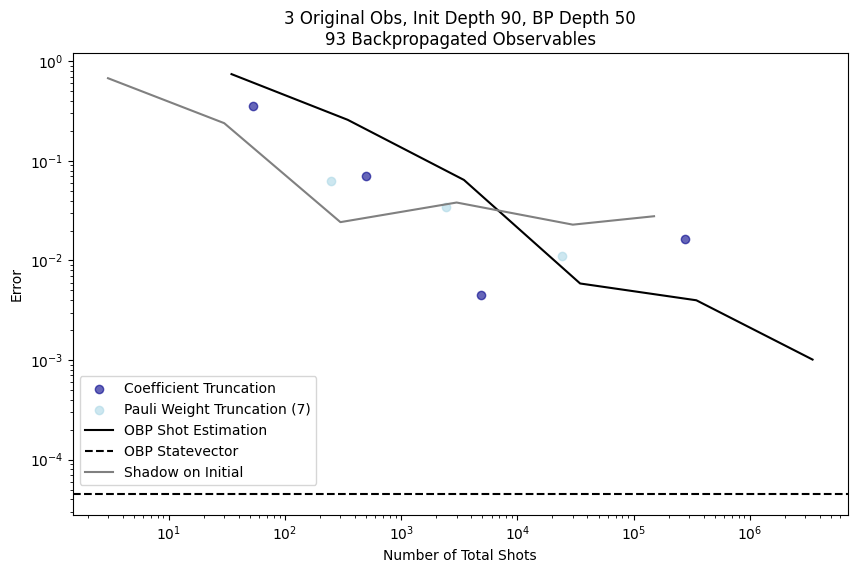

In [150]:
data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'data2'))
coef_df = pd.read_pickle(f'{data_path}/coef-trunc_init90_bp50_obs3.pkl')
pauli_df = pd.read_pickle(f'{data_path}/pauli-trunc7_init90_bp50_obs3.pkl')
obp_df = pd.read_pickle(f'{data_path}/obp_bp50_obs3.pkl')
shad_df = pd.read_pickle(f'{data_path}/shad_res_3.pkl')
state_vector_data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'state_vector_data'))
state_vector_coef_df = pd.read_pickle(f'{state_vector_data_path}/coef-trunc_init90_bp50_obs3.pkl')
state_vector_pauli_df = pd.read_pickle(f'{state_vector_data_path}/pauli-trunc7_init90_bp50_obs3.pkl')
state_vector_coef_df['obs_group'] = state_vector_coef_df.index // obs_num
state_vector_pauli_df['obs_group'] = state_vector_pauli_df.index // obs_num

obp_df['num_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.paulis))
obp_df['num_qwc_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.group_commuting(qubit_wise=True)))
obp_df['num_total_shots'] = obp_df['num_qwc_bp_obs'] * obp_df['obp_shots']

obs_num = 3
coef_df['obs_group'] = coef_df.index // obs_num
obp_df['obs_group'] = obp_df.index // obs_num
shad_df['obs_group'] = shad_df.index // obs_num
pauli_df['obs_group'] = pauli_df.index // obs_num

gb1 = coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb2 = pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb3 = state_vector_coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb4 = state_vector_pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_df.groupby('obs_group').agg({'num_total_shots': 'mean', 'abs_bp_error_shots': 'mean'}).reset_index()

gb_shad = shad_df.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()

plt.figure(figsize=(10, 6))

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Coefficient Truncation', alpha=0.6, color='darkblue')
plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6, color='lightblue')

# plt.axhline(y=gb3['abs_total_error'].mean(), label='Coefficient Truncation Statevector', color='darkblue')
# plt.axhline(y=gb4['abs_total_error'].mean(), label='Pauli Truncation (7) Statevector', color='lightblue', linestyle='--')

sns.lineplot(data=gb_obp, x='num_total_shots', y='abs_bp_error_shots', label='OBP Shot Estimation', color='black')
plt.axhline(y=obp_df['abs_bp_error_state'].mean(), color='black', linestyle='--', label='OBP Statevector')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')

plt.xscale('log')
plt.yscale('log')
plt.title(f'3 Original Obs, Init Depth 90, BP Depth 50\n{int(math.ceil(obp_df["num_bp_obs"].mean()))} Backpropagated Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend(loc='lower left', bbox_to_anchor=(0, 0.05))

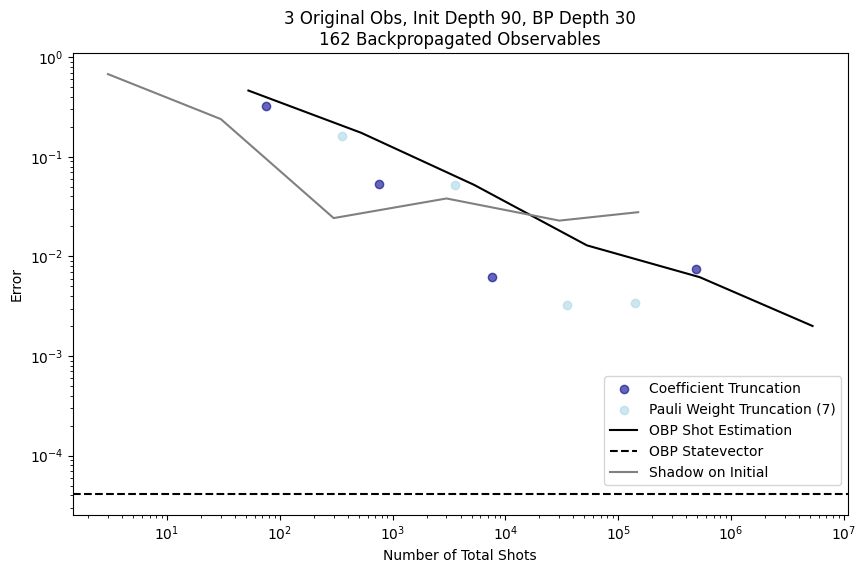

In [151]:
data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'data2'))
coef_df = pd.read_pickle(f'{data_path}/coef-trunc_init90_bp30_obs3.pkl')
pauli_df = pd.read_pickle(f'{data_path}/pauli-trunc7_init90_bp30_obs3.pkl')
obp_df = pd.read_pickle(f'{data_path}/obp_bp30_obs3.pkl')
shad_df = pd.read_pickle(f'{data_path}/shad_res_3.pkl')
state_vector_data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'state_vector_data'))
state_vector_coef_df = pd.read_pickle(f'{state_vector_data_path}/coef-trunc_init90_bp30_obs3.pkl')
state_vector_pauli_df = pd.read_pickle(f'{state_vector_data_path}/pauli-trunc7_init90_bp30_obs3.pkl')
state_vector_coef_df['obs_group'] = state_vector_coef_df.index // obs_num
state_vector_pauli_df['obs_group'] = state_vector_pauli_df.index // obs_num

obp_df['num_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.paulis))
obp_df['num_qwc_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.group_commuting(qubit_wise=True)))
obp_df['num_total_shots'] = obp_df['num_qwc_bp_obs'] * obp_df['obp_shots']

obs_num = 3
coef_df['obs_group'] = coef_df.index // obs_num
obp_df['obs_group'] = obp_df.index // obs_num
shad_df['obs_group'] = shad_df.index // obs_num
pauli_df['obs_group'] = pauli_df.index // obs_num

gb1 = coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb2 = pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb3 = state_vector_coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb4 = state_vector_pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_df.groupby('obs_group').agg({'num_total_shots': 'mean', 'abs_bp_error_shots': 'mean'}).reset_index()

gb_shad = shad_df.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()

plt.figure(figsize=(10, 6))

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Coefficient Truncation', alpha=0.6, color='darkblue')
plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6, color='lightblue')

# plt.axhline(y=gb3['abs_total_error'].mean(), label='Coefficient Truncation Statevector', color='darkblue')
# plt.axhline(y=gb4['abs_total_error'].mean(), label='Pauli Truncation (7) Statevector', color='lightblue', linestyle='--')

sns.lineplot(data=gb_obp, x='num_total_shots', y='abs_bp_error_shots', label='OBP Shot Estimation', color='black')
plt.axhline(y=obp_df['abs_bp_error_state'].mean(), color='black', linestyle='--', label='OBP Statevector')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')

plt.xscale('log')
plt.yscale('log')
plt.title(f'3 Original Obs, Init Depth 90, BP Depth 30\n{int(math.ceil(obp_df["num_bp_obs"].mean()))} Backpropagated Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend(loc='lower right', bbox_to_anchor=(1, 0.05))

In [220]:
# run simulations with statevector
# run with different depths and same initial circuit on few obsrevables
# generate a request for additional node hours

# we need to define a clear set goal that we are working towards on this project, what is the goal of the project, what does our research here accomplish
# try writing an abstract for this, it will obviously change but we need to define a trajectory

86.33333333333333


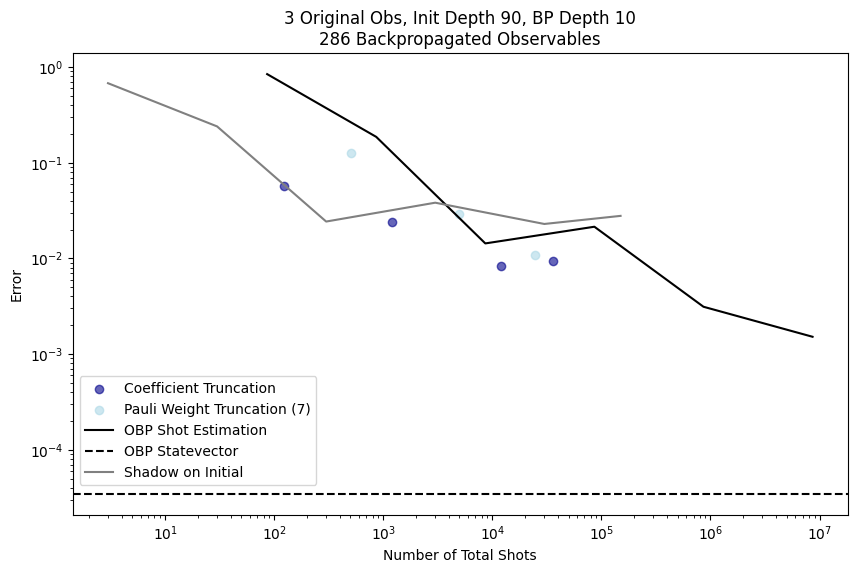

In [22]:
import math

data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'data2'))
coef_df = pd.read_pickle(f'{data_path}/coef-trunc_init90_bp10_obs3.pkl')
pauli_df = pd.read_pickle(f'{data_path}/pauli-trunc7_init90_bp10_obs3.pkl')
obp_df = pd.read_pickle(f'{data_path}/obp_bp10_obs3.pkl')
shad_df = pd.read_pickle(f'{data_path}/shad_res_3.pkl')
state_vector_data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'state_vector_data'))
state_vector_coef_df = pd.read_pickle(f'{state_vector_data_path}/coef-trunc_init90_bp10_obs3.pkl')
state_vector_pauli_df = pd.read_pickle(f'{state_vector_data_path}/pauli-trunc7_init90_bp10_obs3.pkl')


obp_df['num_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.paulis))
obp_df['num_qwc_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.group_commuting(qubit_wise=True)))
obp_df['num_total_shots'] = obp_df['num_qwc_bp_obs'] * obp_df['obp_shots']

obs_num = 3
coef_df['obs_group'] = coef_df.index // obs_num
obp_df['obs_group'] = obp_df.index // obs_num
shad_df['obs_group'] = shad_df.index // obs_num
pauli_df['obs_group'] = pauli_df.index // obs_num
state_vector_coef_df['obs_group'] = state_vector_coef_df.index // obs_num
state_vector_pauli_df['obs_group'] = state_vector_pauli_df.index // obs_num

gb1 = coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb2 = pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb3 = state_vector_coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb4 = state_vector_pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_df.groupby('obs_group').agg({'num_total_shots': 'mean', 'abs_bp_error_shots': 'mean'}).reset_index()

gb_shad = shad_df.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()

plt.figure(figsize=(10, 6))

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Coefficient Truncation', alpha=0.6, color='darkblue')
plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6, color='lightblue')

# plt.axhline(y=gb3['abs_total_error'].mean(), label='Coefficient Truncation Statevector', color='darkblue')
# plt.axhline(y=gb4['abs_total_error'].mean(), label='Pauli Truncation (7) Statevector', color='lightblue', linestyle='--')

sns.lineplot(data=gb_obp, x='num_total_shots', y='abs_bp_error_shots', label='OBP Shot Estimation', color='black')
plt.axhline(y=obp_df['abs_bp_error_state'].mean(), color='black', linestyle='--', label='OBP Statevector')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')

plt.xscale('log')
plt.yscale('log')
plt.title(f'3 Original Obs, Init Depth 90, BP Depth 10\n{int(math.ceil(obp_df["num_bp_obs"].mean()))} Backpropagated Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend(loc='lower left', bbox_to_anchor=(0, 0.05))
print(obp_df['num_qwc_bp_obs'].mean())

In [134]:
obp_df

,backpropagated slices,number of terms,number of groups,max error,error is bounded by,bp_obs,bp_circuit,obs,circuit,bp_circuit_depth,bp_exp_shots,exact_exp,bp_exp_state,obp_shots,circuit_depth,abs_bp_error_shots,bp_error_shots,abs_bp_error_state,bp_error_state,obs_group
0,85,265,87,0.0001,0.008497,"[[[SparsePauliOp(['ZZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",5,0.833323,0.943229,0.943233,1,90,0.109906,0.109906,0.000004,-0.000004,0
1,85,345,100,0.0001,0.008498,"[[[SparsePauliOp(['ZXIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZXIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",5,-0.804674,0.149610,0.149664,1,90,0.954284,0.954284,0.000055,-0.000055,0
2,85,323,95,0.0001,0.008495,"[[[SparsePauliOp(['ZYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",5,-0.981559,-0.174343,-0.174376,1,90,0.807216,0.807216,0.000033,0.000033,0
3,85,265,87,0.0001,0.008497,"[[[SparsePauliOp(['ZZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",5,0.970343,0.943229,0.943233,10,90,0.027114,-0.027114,0.000004,-0.000004,1
4,85,345,100,0.0001,0.008498,"[[[SparsePauliOp(['ZXIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZXIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",5,0.436592,0.149610,0.149664,10,90,0.286983,-0.286983,0.000055,-0.000055,1
5,85,323,95,0.0001,0.008495,"[[[SparsePauliOp(['ZYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",5,-0.569600,-0.174343,-0.174376,10,90,0.395256,0.395256,0.000033,0.000033,1
6,85,265,87,0.0001,0.008497,"[[[SparsePauliOp(['ZZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",5,0.925452,0.943229,0.943233,100,90,0.017777,0.017777,0.000004,-0.000004,2
7,85,345,100,0.0001,0.008498,"[[[SparsePauliOp(['ZXIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZXIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",5,0.239927,0.149610,0.149664,100,90,0.090317,-0.090317,0.000055,-0.000055,2
8,85,323,95,0.0001,0.008495,"[[[SparsePauliOp(['ZYIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZYIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",5,-0.215777,-0.174343,-0.174376,100,90,0.041434,0.041434,0.000033,0.000033,2
9,85,265,87,0.0001,0.008497,"[[[SparsePauliOp(['ZZIIIIIIII'],\n ...","((Instruction(name='rxx', num_qubits=2, num_cl...",ZZIIIIIIII,"((Instruction(name='rxx', num_qubits=2, num_cl...",5,0.948695,0.943229,0.943233,1000,90,0.005466,-0.005466,0.000004,-0.000004,3


94.0


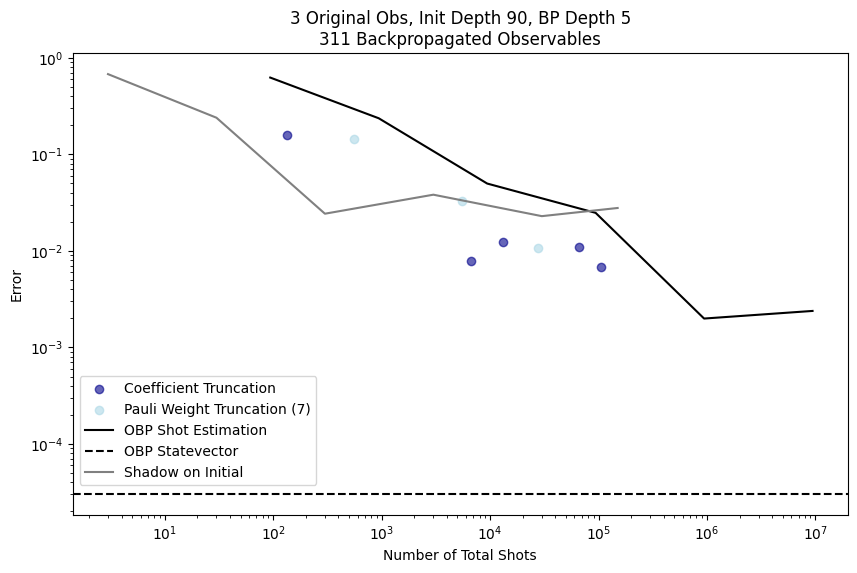

In [154]:
data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'data2'))
coef_df = pd.read_pickle(f'{data_path}/coef-trunc_init90_bp5_obs3.pkl')
pauli_df = pd.read_pickle(f'{data_path}/pauli-trunc7_init90_bp5_obs3.pkl')
obp_df = pd.read_pickle(f'{data_path}/obp_bp5_obs3.pkl')
shad_df = pd.read_pickle(f'{data_path}/shad_res_3.pkl')
state_vector_data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'state_vector_data'))
state_vector_coef_df = pd.read_pickle(f'{state_vector_data_path}/coef-trunc_init90_bp5_obs3.pkl')
state_vector_pauli_df = pd.read_pickle(f'{state_vector_data_path}/pauli-trunc7_init90_bp5_obs3.pkl')
state_vector_coef_df['obs_group'] = state_vector_coef_df.index // obs_num
state_vector_pauli_df['obs_group'] = state_vector_pauli_df.index // obs_num

obp_df['num_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.paulis))
obp_df['num_qwc_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.group_commuting(qubit_wise=True)))
obp_df['num_total_shots'] = obp_df['num_qwc_bp_obs'] * obp_df['obp_shots']

obs_num = 3
coef_df['obs_group'] = coef_df.index // obs_num
obp_df['obs_group'] = obp_df.index // obs_num
shad_df['obs_group'] = shad_df.index // obs_num
pauli_df['obs_group'] = pauli_df.index // obs_num

gb1 = coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb2 = pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb3 = state_vector_coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb4 = state_vector_pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_df.groupby('obs_group').agg({'num_total_shots': 'mean', 'abs_bp_error_shots': 'mean'}).reset_index()

gb_shad = shad_df.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()

plt.figure(figsize=(10, 6))

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Coefficient Truncation', alpha=0.6, color='darkblue')
plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6, color='lightblue')

# plt.axhline(y=gb3['abs_total_error'].mean(), label='Coefficient Truncation Statevector', color='darkblue')
# plt.axhline(y=gb4['abs_total_error'].mean(), label='Pauli Truncation (7) Statevector', color='lightblue', linestyle='--')

sns.lineplot(data=gb_obp, x='num_total_shots', y='abs_bp_error_shots', label='OBP Shot Estimation', color='black')
plt.axhline(y=obp_df['abs_bp_error_state'].mean(), color='black', linestyle='--', label='OBP Statevector')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')

plt.xscale('log')
plt.yscale('log')
plt.title(f'3 Original Obs, Init Depth 90, BP Depth 5\n{int(math.ceil(obp_df["num_bp_obs"].mean()))} Backpropagated Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend(loc='lower left', bbox_to_anchor=(0, 0.05))

print(obp_df['num_qwc_bp_obs'].mean())

89.44444444444444
Intersection at num_total_shots ≈ 79568.05
OBP-Shadow improvement is 3.70 times the minimum number of measurements for the coefficient truncation method.


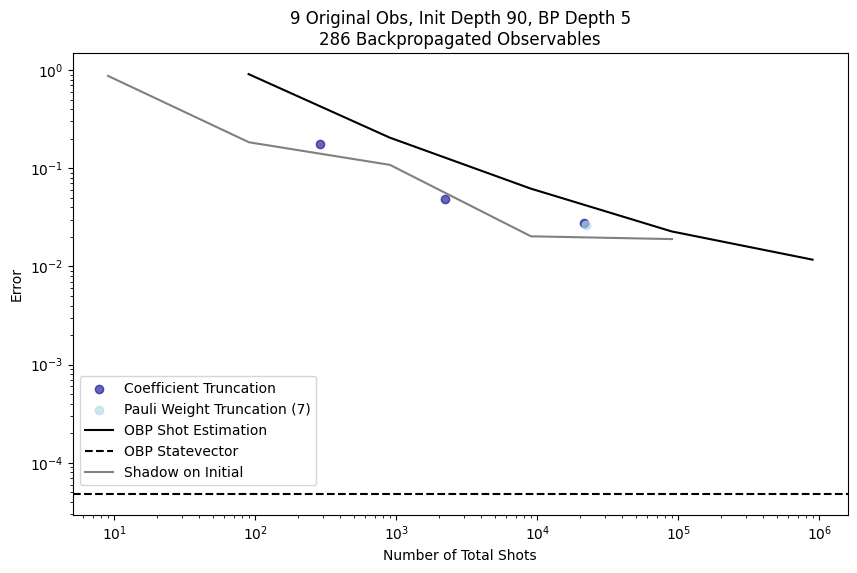

In [48]:
data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'data3'))
coef_df = pd.read_pickle(f'{data_path}/coef-trunc_init90_bp5_obs9.pkl')
pauli_df = pd.read_pickle(f'{data_path}/pauli-trunc7_init90_bp5_obs9.pkl')
obp_df = pd.read_pickle(f'{data_path}/obp_bp5_obs9.pkl')
shad_df = pd.read_pickle(f'{data_path}/shad_res_9.pkl')

obp_df['num_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.paulis))
obp_df['num_qwc_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.group_commuting(qubit_wise=True)))
obp_df['num_total_shots'] = obp_df['num_qwc_bp_obs'] * obp_df['obp_shots']

obs_num = 9
coef_df['obs_group'] = coef_df.index // obs_num
obp_df['obs_group'] = obp_df.index // obs_num
shad_df['obs_group'] = shad_df.index // obs_num
pauli_df['obs_group'] = pauli_df.index // obs_num

gb1 = coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb2 = pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_df.groupby('obs_group').agg({'num_total_shots': 'mean', 'abs_bp_error_shots': 'mean'}).reset_index()

gb_shad = shad_df.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()

plt.figure(figsize=(10, 6))

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Coefficient Truncation', alpha=0.6, color='darkblue')
plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6, color='lightblue')

sns.lineplot(data=gb_obp, x='num_total_shots', y='abs_bp_error_shots', label='OBP Shot Estimation', color='black')
plt.axhline(y=obp_df['abs_bp_error_state'].mean(), color='black', linestyle='--', label='OBP Statevector')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')

plt.xscale('log')
plt.yscale('log')
plt.title(f'9 Original Obs, Init Depth 90, BP Depth 5\n{int(math.ceil(obp_df["num_bp_obs"].mean()))} Backpropagated Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend(loc='lower left', bbox_to_anchor=(0, 0.05))

print(obp_df['num_qwc_bp_obs'].mean())

y_hline = gb1['abs_total_error'].min()
y_min = gb1[gb1['abs_total_error'] == y_hline]['num_meas'].values[0]
diff = gb_obp['abs_bp_error_shots'] - y_hline
crossings = diff.shift(-1) * diff < 0
for idx in gb_obp.index[crossings]:
    x0 = gb_obp.loc[idx, 'num_total_shots']
    y0 = gb_obp.loc[idx, 'abs_bp_error_shots']
    x1 = gb_obp.loc[idx + 1, 'num_total_shots']
    y1 = gb_obp.loc[idx + 1, 'abs_bp_error_shots']
    # Linear interpolation
    if y1 != y0:
        x_intersect = x0 + (y_hline - y0) * (x1 - x0) / (y1 - y0)
        print(f"Intersection at num_total_shots ≈ {x_intersect:.2f}")
        print(f"OBP-Shadow improvement is {x_intersect / y_min:.2f} times the minimum number of measurements for the coefficient truncation method.")

82.0
Intersection at num_total_shots ≈ 744827.65
OBP-Shadow improvement is 8.37 times the minimum number of measurements for the coefficient truncation method.


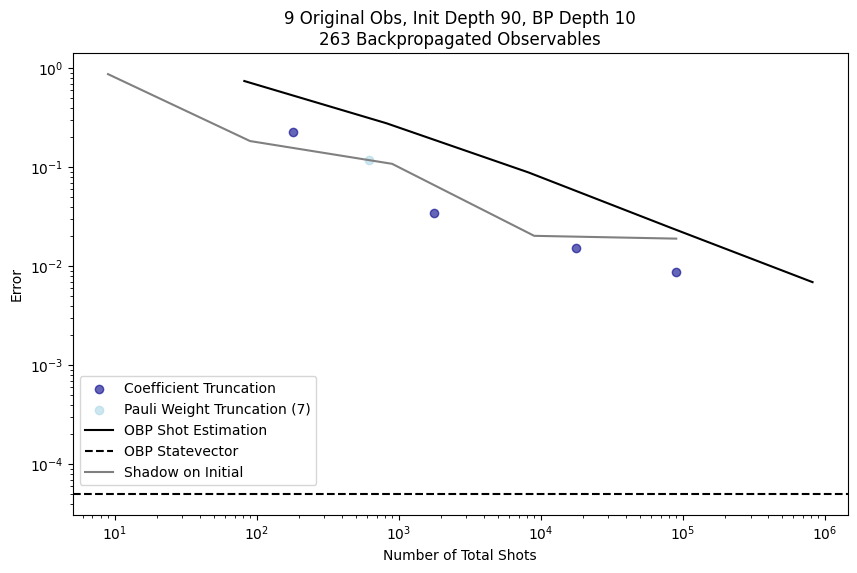

In [44]:
data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'data3'))
coef_df = pd.read_pickle(f'{data_path}/coef-trunc_init90_bp10_obs9.pkl')
pauli_df = pd.read_pickle(f'{data_path}/pauli-trunc7_init90_bp10_obs9.pkl')
obp_df = pd.read_pickle(f'{data_path}/obp_bp10_obs9.pkl')
shad_df = pd.read_pickle(f'{data_path}/shad_res_9.pkl')

obp_df['num_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.paulis))
obp_df['num_qwc_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.group_commuting(qubit_wise=True)))
obp_df['num_total_shots'] = obp_df['num_qwc_bp_obs'] * obp_df['obp_shots']

obs_num = 9
coef_df['obs_group'] = coef_df.index // obs_num
obp_df['obs_group'] = obp_df.index // obs_num
shad_df['obs_group'] = shad_df.index // obs_num
pauli_df['obs_group'] = pauli_df.index // obs_num

gb1 = coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
gb2 = pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_df.groupby('obs_group').agg({'num_total_shots': 'mean', 'abs_bp_error_shots': 'mean'}).reset_index()

gb_shad = shad_df.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()

plt.figure(figsize=(10, 6))

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Coefficient Truncation', alpha=0.6, color='darkblue')
plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6, color='lightblue')

sns.lineplot(data=gb_obp, x='num_total_shots', y='abs_bp_error_shots', label='OBP Shot Estimation', color='black')
plt.axhline(y=obp_df['abs_bp_error_state'].mean(), color='black', linestyle='--', label='OBP Statevector')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')

plt.xscale('log')
plt.yscale('log')
plt.title(f'9 Original Obs, Init Depth 90, BP Depth 10\n{int(math.ceil(obp_df["num_bp_obs"].mean()))} Backpropagated Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend(loc='lower left', bbox_to_anchor=(0, 0.05))

print(obp_df['num_qwc_bp_obs'].mean())

y_hline = gb1['abs_total_error'].min()
y_min = gb1[gb1['abs_total_error'] == y_hline]['num_meas'].values[0]
diff = gb_obp['abs_bp_error_shots'] - y_hline
crossings = diff.shift(-1) * diff < 0
for idx in gb_obp.index[crossings]:
    x0 = gb_obp.loc[idx, 'num_total_shots']
    y0 = gb_obp.loc[idx, 'abs_bp_error_shots']
    x1 = gb_obp.loc[idx + 1, 'num_total_shots']
    y1 = gb_obp.loc[idx + 1, 'abs_bp_error_shots']
    # Linear interpolation
    if y1 != y0:
        x_intersect = x0 + (y_hline - y0) * (x1 - x0) / (y1 - y0)
        print(f"Intersection at num_total_shots ≈ {x_intersect:.2f}")
        print(f"OBP-Shadow improvement is {x_intersect / y_min:.2f} times the minimum number of measurements for the coefficient truncation method.")

50.77777777777778
Intersection at num_total_shots ≈ 471243.55
OBP-Shadow improvement is 9.62 times the minimum number of measurements for the coefficient truncation method.


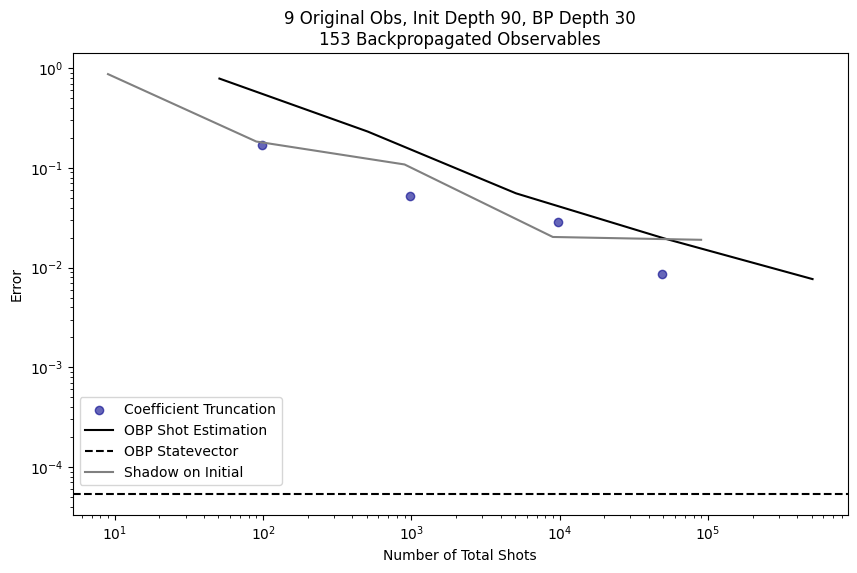

In [49]:
data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'data3'))
coef_df = pd.read_pickle(f'{data_path}/coef-trunc_init90_bp30_obs9.pkl')
# pauli_df = pd.read_pickle(f'{data_path}/pauli-trunc7_init90_bp30_obs9.pkl')
obp_df = pd.read_pickle(f'{data_path}/obp_bp30_obs9.pkl')
shad_df = pd.read_pickle(f'{data_path}/shad_res_9.pkl')

obp_df['num_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.paulis))
obp_df['num_qwc_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.group_commuting(qubit_wise=True)))
obp_df['num_total_shots'] = obp_df['num_qwc_bp_obs'] * obp_df['obp_shots']

obs_num = 9
coef_df['obs_group'] = coef_df.index // obs_num
obp_df['obs_group'] = obp_df.index // obs_num
shad_df['obs_group'] = shad_df.index // obs_num
# pauli_df['obs_group'] = pauli_df.index // obs_num

gb1 = coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
# gb2 = pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_df.groupby('obs_group').agg({'num_total_shots': 'mean', 'abs_bp_error_shots': 'mean'}).reset_index()

gb_shad = shad_df.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()

plt.figure(figsize=(10, 6))

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Coefficient Truncation', alpha=0.6, color='darkblue')
# plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6, color='lightblue')

sns.lineplot(data=gb_obp, x='num_total_shots', y='abs_bp_error_shots', label='OBP Shot Estimation', color='black')
plt.axhline(y=obp_df['abs_bp_error_state'].mean(), color='black', linestyle='--', label='OBP Statevector')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')
# plt.axhline(y=gb1['abs_total_error'].min(), color='darkblue', linestyle='--')

plt.xscale('log')
plt.yscale('log')
plt.title(f'9 Original Obs, Init Depth 90, BP Depth 30\n{int(math.ceil(obp_df["num_bp_obs"].mean()))} Backpropagated Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend(loc='lower left', bbox_to_anchor=(0, 0.05))

print(obp_df['num_qwc_bp_obs'].mean())

y_hline = gb1['abs_total_error'].min()
y_min = gb1[gb1['abs_total_error'] == y_hline]['num_meas'].values[0]
diff = gb_obp['abs_bp_error_shots'] - y_hline
crossings = diff.shift(-1) * diff < 0
for idx in gb_obp.index[crossings]:
    x0 = gb_obp.loc[idx, 'num_total_shots']
    y0 = gb_obp.loc[idx, 'abs_bp_error_shots']
    x1 = gb_obp.loc[idx + 1, 'num_total_shots']
    y1 = gb_obp.loc[idx + 1, 'abs_bp_error_shots']
    # Linear interpolation
    if y1 != y0:
        x_intersect = x0 + (y_hline - y0) * (x1 - x0) / (y1 - y0)
        print(f"Intersection at num_total_shots ≈ {x_intersect:.2f}")
        print(f"OBP-Shadow improvement is {x_intersect / y_min:.2f} times the minimum number of measurements for the coefficient truncation method.")

55.44444444444444
Intersection at num_total_shots ≈ 277976.38
OBP-Shadow improvement is 17.14 times the minimum number of measurements for the coefficient truncation method.


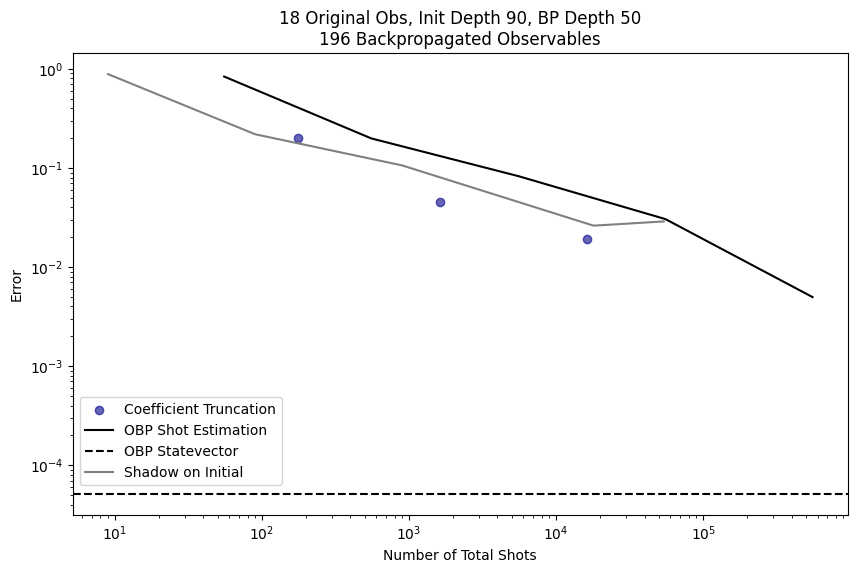

In [53]:
data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'data4'))
coef_df = pd.read_pickle(f'{data_path}/coef-trunc_init90_bp50_obs18.pkl')
# pauli_df = pd.read_pickle(f'{data_path}/pauli-trunc7_init90_bp30_obs9.pkl')
obp_df = pd.read_pickle(f'{data_path}/obp_bp50_obs18.pkl')
shad_df = pd.read_pickle(f'{data_path}/shad_res_18.pkl')

obp_df['num_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.paulis))
obp_df['num_qwc_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.group_commuting(qubit_wise=True)))
obp_df['num_total_shots'] = obp_df['num_qwc_bp_obs'] * obp_df['obp_shots']

obs_num = 18
coef_df['obs_group'] = coef_df.index // obs_num
obp_df['obs_group'] = obp_df.index // obs_num
shad_df['obs_group'] = shad_df.index // obs_num
# pauli_df['obs_group'] = pauli_df.index // obs_num

gb1 = coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
# gb2 = pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_df.groupby('obs_group').agg({'num_total_shots': 'mean', 'abs_bp_error_shots': 'mean'}).reset_index()

gb_shad = shad_df.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()

plt.figure(figsize=(10, 6))

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Coefficient Truncation', alpha=0.6, color='darkblue')
# plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6, color='lightblue')

sns.lineplot(data=gb_obp, x='num_total_shots', y='abs_bp_error_shots', label='OBP Shot Estimation', color='black')
plt.axhline(y=obp_df['abs_bp_error_state'].mean(), color='black', linestyle='--', label='OBP Statevector')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')
# plt.axhline(y=gb1['abs_total_error'].min(), color='darkblue', linestyle='--')

plt.xscale('log')
plt.yscale('log')
plt.title(f'18 Original Obs, Init Depth 90, BP Depth 50\n{int(math.ceil(obp_df["num_bp_obs"].mean()))} Backpropagated Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend(loc='lower left', bbox_to_anchor=(0, 0.05))

print(obp_df['num_qwc_bp_obs'].mean())

y_hline = gb1['abs_total_error'].min()
y_min = gb1[gb1['abs_total_error'] == y_hline]['num_meas'].values[0]
diff = gb_obp['abs_bp_error_shots'] - y_hline
crossings = diff.shift(-1) * diff < 0
for idx in gb_obp.index[crossings]:
    x0 = gb_obp.loc[idx, 'num_total_shots']
    y0 = gb_obp.loc[idx, 'abs_bp_error_shots']
    x1 = gb_obp.loc[idx + 1, 'num_total_shots']
    y1 = gb_obp.loc[idx + 1, 'abs_bp_error_shots']
    # Linear interpolation
    if y1 != y0:
        x_intersect = x0 + (y_hline - y0) * (x1 - x0) / (y1 - y0)
        print(f"Intersection at num_total_shots ≈ {x_intersect:.2f}")
        print(f"OBP-Shadow improvement is {x_intersect / y_min:.2f} times the minimum number of measurements for the coefficient truncation method.")

90.27777777777777
Intersection at num_total_shots ≈ 723782.55
OBP-Shadow improvement is 24.77 times the minimum number of measurements for the coefficient truncation method.


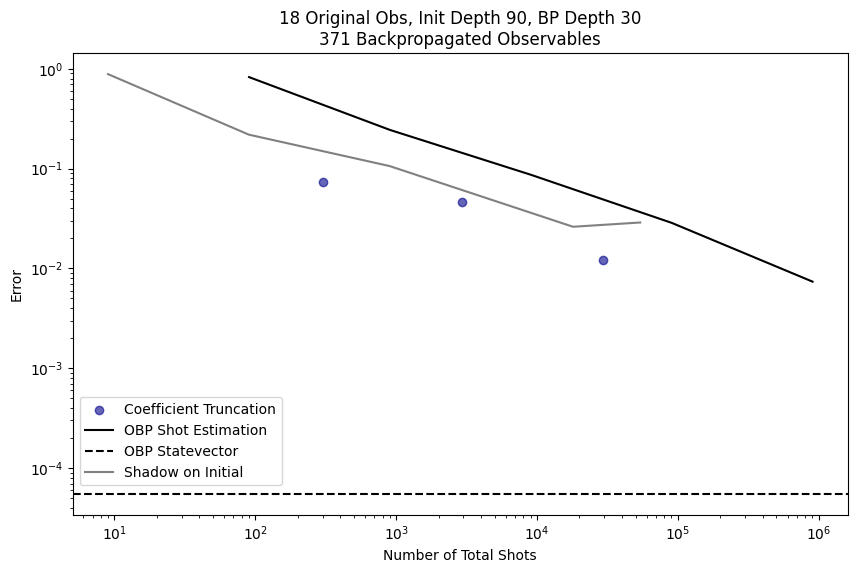

In [60]:
data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'data4'))
coef_df = pd.read_pickle(f'{data_path}/coef-trunc_init90_bp30_obs18.pkl')
# pauli_df = pd.read_pickle(f'{data_path}/pauli-trunc7_init90_bp30_obs9.pkl')
obp_df = pd.read_pickle(f'{data_path}/obp_bp30_obs18.pkl')
shad_df = pd.read_pickle(f'{data_path}/shad_res_18.pkl')

obp_df['num_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.paulis))
obp_df['num_qwc_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.group_commuting(qubit_wise=True)))
obp_df['num_total_shots'] = obp_df['num_qwc_bp_obs'] * obp_df['obp_shots']

obs_num = 18
coef_df['obs_group'] = coef_df.index // obs_num
obp_df['obs_group'] = obp_df.index // obs_num
shad_df['obs_group'] = shad_df.index // obs_num
# pauli_df['obs_group'] = pauli_df.index // obs_num

gb1 = coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
# gb2 = pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_df.groupby('obs_group').agg({'num_total_shots': 'mean', 'abs_bp_error_shots': 'mean'}).reset_index()

gb_shad = shad_df.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()

plt.figure(figsize=(10, 6))

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Coefficient Truncation', alpha=0.6, color='darkblue')
# plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6, color='lightblue')

sns.lineplot(data=gb_obp, x='num_total_shots', y='abs_bp_error_shots', label='OBP Shot Estimation', color='black')
plt.axhline(y=obp_df['abs_bp_error_state'].mean(), color='black', linestyle='--', label='OBP Statevector')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')
# plt.axhline(y=gb1['abs_total_error'].min(), color='darkblue', linestyle='--')

plt.xscale('log')
plt.yscale('log')
plt.title(f'18 Original Obs, Init Depth 90, BP Depth 30\n{int(math.ceil(obp_df["num_bp_obs"].mean()))} Backpropagated Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend(loc='lower left', bbox_to_anchor=(0, 0.05))

print(obp_df['num_qwc_bp_obs'].mean())

y_hline = gb1['abs_total_error'].min()
y_min = gb1[gb1['abs_total_error'] == y_hline]['num_meas'].values[0]
diff = gb_obp['abs_bp_error_shots'] - y_hline
crossings = diff.shift(-1) * diff < 0
for idx in gb_obp.index[crossings]:
    x0 = gb_obp.loc[idx, 'num_total_shots']
    y0 = gb_obp.loc[idx, 'abs_bp_error_shots']
    x1 = gb_obp.loc[idx + 1, 'num_total_shots']
    y1 = gb_obp.loc[idx + 1, 'abs_bp_error_shots']
    # Linear interpolation
    if y1 != y0:
        x_intersect = x0 + (y_hline - y0) * (x1 - x0) / (y1 - y0)
        print(f"Intersection at num_total_shots ≈ {x_intersect:.2f}")
        print(f"OBP-Shadow improvement is {x_intersect / y_min:.2f} times the minimum number of measurements for the coefficient truncation method.")

167.77777777777777
Intersection at num_total_shots ≈ 2801333.66
OBP-Shadow improvement is 12.15 times the minimum number of measurements for the coefficient truncation method.


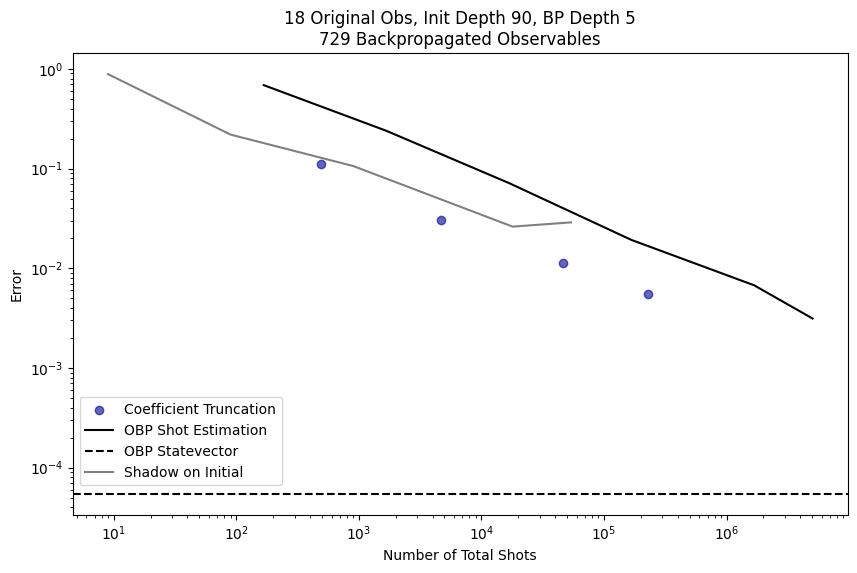

In [61]:
data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'data4'))
coef_df = pd.read_pickle(f'{data_path}/coef-trunc_init90_bp5_obs18.pkl')
# pauli_df = pd.read_pickle(f'{data_path}/pauli-trunc7_init90_bp5_obs9.pkl')
obp_df = pd.read_pickle(f'{data_path}/obp_bp5_obs18.pkl')
shad_df = pd.read_pickle(f'{data_path}/shad_res_18.pkl')

obp_df['num_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.paulis))
obp_df['num_qwc_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.group_commuting(qubit_wise=True)))
obp_df['num_total_shots'] = obp_df['num_qwc_bp_obs'] * obp_df['obp_shots']

obs_num = 18
coef_df['obs_group'] = coef_df.index // obs_num
obp_df['obs_group'] = obp_df.index // obs_num
shad_df['obs_group'] = shad_df.index // obs_num
# pauli_df['obs_group'] = pauli_df.index // obs_num

gb1 = coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
# gb2 = pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_df.groupby('obs_group').agg({'num_total_shots': 'mean', 'abs_bp_error_shots': 'mean'}).reset_index()

gb_shad = shad_df.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()

plt.figure(figsize=(10, 6))

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Coefficient Truncation', alpha=0.6, color='darkblue')
# plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6, color='lightblue')

sns.lineplot(data=gb_obp, x='num_total_shots', y='abs_bp_error_shots', label='OBP Shot Estimation', color='black')
plt.axhline(y=obp_df['abs_bp_error_state'].mean(), color='black', linestyle='--', label='OBP Statevector')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')
# plt.axhline(y=gb1['abs_total_error'].min(), color='darkblue', linestyle='--')

# plt.annotate('24.27x improvement', 
#              xy=(8e4, 1e-2),  # Point to annotate
#              xytext=(1.2e5, 2e-2),  # Text position
#              bbox=dict(facecolor='white', edgecolor='black', alpha=0.7),
#              arrowprops=dict(arrowstyle='->'))

plt.xscale('log')
plt.yscale('log')
plt.title(f'18 Original Obs, Init Depth 90, BP Depth 5\n{int(math.ceil(obp_df["num_bp_obs"].mean()))} Backpropagated Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend(loc='lower left', bbox_to_anchor=(0, 0.05))

print(obp_df['num_qwc_bp_obs'].mean())

y_hline = gb1['abs_total_error'].min()
y_min = gb1[gb1['abs_total_error'] == y_hline]['num_meas'].values[0]
diff = gb_obp['abs_bp_error_shots'] - y_hline
crossings = diff.shift(-1) * diff < 0
for idx in gb_obp.index[crossings]:
    x0 = gb_obp.loc[idx, 'num_total_shots']
    y0 = gb_obp.loc[idx, 'abs_bp_error_shots']
    x1 = gb_obp.loc[idx + 1, 'num_total_shots']
    y1 = gb_obp.loc[idx + 1, 'abs_bp_error_shots']
    # Linear interpolation
    if y1 != y0:
        x_intersect = x0 + (y_hline - y0) * (x1 - x0) / (y1 - y0)
        print(f"Intersection at num_total_shots ≈ {x_intersect:.2f}")
        print(f"OBP-Shadow improvement is {x_intersect / y_min:.2f} times the minimum number of measurements for the coefficient truncation method.")

In [55]:
data_path = os.path.abspath(os.path.join(os.getcwd(), '..', 'data5'))
coef_df = pd.read_pickle(f'{data_path}/coef-trunc_init90_bp5_obs36.pkl')
# pauli_df = pd.read_pickle(f'{data_path}/pauli-trunc7_init90_bp5_obs9.pkl')
shad_df = pd.read_pickle(f'{data_path}/shad_res_36.pkl')

In [56]:
obp_df = pd.read_pickle(f'{data_path}/obp_bp5_obs36.pkl')
obp_df['num_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.paulis))
obp_df['num_qwc_bp_obs'] = obp_df['bp_obs'].apply(lambda x: len(x.group_commuting(qubit_wise=True)))
obp_df['num_total_shots'] = obp_df['num_qwc_bp_obs'] * obp_df['obp_shots']

In [57]:
obs_num = 36
coef_df['obs_group'] = coef_df.index // obs_num
obp_df['obs_group'] = obp_df.index // obs_num
shad_df['obs_group'] = shad_df.index // obs_num
# pauli_df['obs_group'] = pauli_df.index // obs_num

In [58]:
gb1 = coef_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()
# gb2 = pauli_df.groupby('obs_group').agg({'abs_total_error': 'mean', 'num_meas': 'mean'}).reset_index()

gb_obp = obp_df.groupby('obs_group').agg({'num_total_shots': 'mean', 'abs_bp_error_shots': 'mean'}).reset_index()

gb_shad = shad_df.groupby('num_meas').agg({'abs_shad_error': 'mean'}).reset_index()
# gb_shad = gb_shad[gb_shad['num_meas'] > 50]

309.69444444444446
Intersection at num_total_shots ≈ 2755258.50
OBP-Shadow improvement is 24.98 times the minimum number of measurements for the coefficient truncation method.


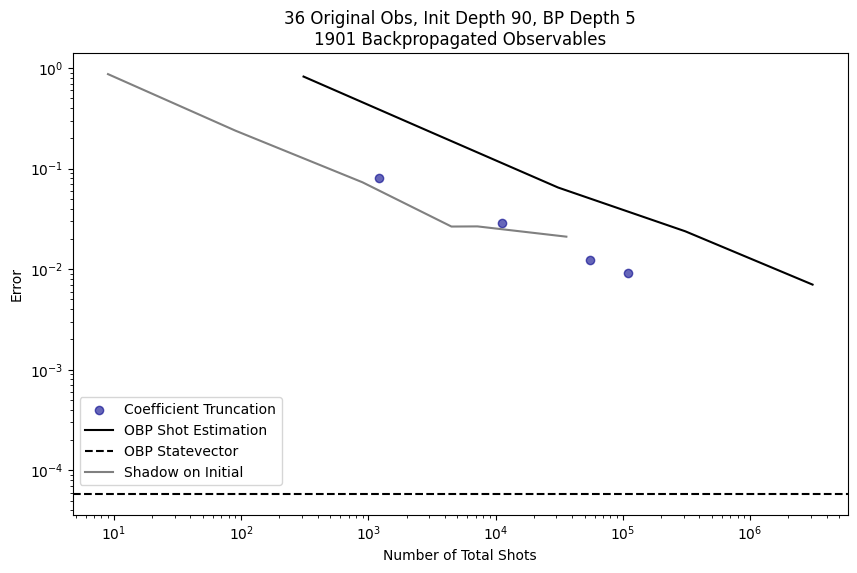

In [59]:
plt.figure(figsize=(10, 6))

plt.scatter(x=gb1['num_meas'], y=gb1['abs_total_error'], label='Coefficient Truncation', alpha=0.6, color='darkblue')
# plt.scatter(x=gb2['num_meas'], y=gb2['abs_total_error'], label='Pauli Weight Truncation (7)', alpha=0.6, color='lightblue')

sns.lineplot(data=gb_obp, x='num_total_shots', y='abs_bp_error_shots', label='OBP Shot Estimation', color='black')
plt.axhline(y=obp_df['abs_bp_error_state'].mean(), color='black', linestyle='--', label='OBP Statevector')
sns.lineplot(data=gb_shad, x='num_meas', y='abs_shad_error', label='Shadow on Initial', color='gray')
# plt.axhline(y=gb1['abs_total_error'].min(), color='darkblue', linestyle='--')

plt.xscale('log')
plt.yscale('log')
plt.title(f'36 Original Obs, Init Depth 90, BP Depth 5\n{int(math.ceil(obp_df["num_bp_obs"].mean()))} Backpropagated Observables')
plt.xlabel('Number of Total Shots')
plt.ylabel('Error')

plt.legend(loc='lower left', bbox_to_anchor=(0, 0.05))

print(obp_df['num_qwc_bp_obs'].mean())

y_hline = gb1['abs_total_error'].min()
y_min = gb1[gb1['abs_total_error'] == y_hline]['num_meas'].values[0]
diff = gb_obp['abs_bp_error_shots'] - y_hline
crossings = diff.shift(-1) * diff < 0
for idx in gb_obp.index[crossings]:
    x0 = gb_obp.loc[idx, 'num_total_shots']
    y0 = gb_obp.loc[idx, 'abs_bp_error_shots']
    x1 = gb_obp.loc[idx + 1, 'num_total_shots']
    y1 = gb_obp.loc[idx + 1, 'abs_bp_error_shots']
    # Linear interpolation
    if y1 != y0:
        x_intersect = x0 + (y_hline - y0) * (x1 - x0) / (y1 - y0)
        print(f"Intersection at num_total_shots ≈ {x_intersect:.2f}")
        print(f"OBP-Shadow improvement is {x_intersect / y_min:.2f} times the minimum number of measurements for the coefficient truncation method.")